# Pre-Process Decagon Data and Save Using Pickle

## Highlight



The frequency distribution of DD edge types is shown in the following figure. In Zinik(2018)'s work, they remove the DD edge types that each occurred in less than 500 drug combinations. Therefore, they use the sub-dataset of what we described and analyzed in this notebook.
![](hist_dd_edge.png)

Here is the summary of the data they use:
- protein: 19k
- protein edge: 1431k
- drug: 645
- drug edge: 6966k
- drug edge type: 963
- drug with protein link (dwp): 284
- dwp edge: 1810k
- drug feature: dim 10k, {0, 1} binary valued


## 1. Analysis Nodes, Edges, Node Features and Edge Types

In [ ]:
!pip3 install stellargraph

     |████████████████████████████████| 440kB 18.3MB/s 
ERROR: Operation cancelled by user


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

!mkdir ./Effectants/

## Creates RAM-Disk for potential speed-up
!sudo mount -t tmpfs -o size=12g tmpfs Effectants
#!sudo mount -t tmpfs -o size=12g tmpfs RAW
!cp -r "drive/My Drive/GNN" ./Effectants/
#!cp -r "drive/My Drive/VAE/" ./VAE/
#!cp -r "drive/My Drive/RAW/" ./RAW/

Mounted at /content/drive/
cp: cannot open 'drive/My Drive/GNN/Notes.gdoc' for reading: Operation not supported


In [ ]:
#ls Effectants/GNN/GNN/      

In [ ]:
import csv

In [ ]:
# set data paths
pp_f = "Effectants/GNN/GNN/data/bio-decagon-ppi.csv"
dd_f = "Effectants/GNN/GNN/data/bio-decagon-combo.csv"
dp_f = "Effectants/GNN/GNN/data/bio-decagon-targets.csv"
ds_f = "Effectants/GNN/GNN/data/bio-decagon-mono.csv"


In [ ]:
# original data collection holder
p_set = set()                 # protein nodes
d_set = set()                 # drug nodes
combo_set = set()             # edge types
mono_set = set()              # additional drug features

# read file to list
pp_list, ddt_list, dp_list, ds_list = [], [], [], []   # lists of tuples

# set temporary variable
a, b, c = 0, 0, 0

### 1.1 protein-protein association network

Includes:

- physical interaction
- functional associations

Notation:

- node: protein
- edge: association or interaction

Number:

- 19081 nodes (min: 1; max: 110255169)
- 715612 edges

In [ ]:
with open(pp_f, 'r') as f:
    ppi = csv.reader(f)
    next(ppi)
    for [g1, g2] in ppi:
        a, b = int(g1), int(g2)
        p_set.add(a)
        p_set.add(b)
        pp_list.append((a, b))
print("{:d} protein nodes indexed from {:d} to {:d}.".format(len(p_set), min(p_set), max(p_set)))
print("{:d} protein-protein edges".format(len(pp_list)))

19081 protein nodes indexed from 1 to 110255169.
715612 protein-protein edges


### 1.2 drug-drug association network with side effects

!! TIME COSTY SECTION

Notation:

- node: drug
- edge with typies: type of side effects that are associated with drug pairs

Number:

- 645 nodes
- 63473 edges
- 1317 edge types

In [ ]:
with open("Effectants/GNN/GNN/data/bio-decagon-combo.csv", "r") as f:
    ppi = csv.reader(f)
    next(ppi)
    for [d1, d2, t, n] in ppi:
        a, b, c = int(t.split('C')[-1]), int(d1.split('D')[-1]), int(d2.split('D')[-1])
        combo_set.add(a)
        d_set.add(b)
        d_set.add(c)
        ddt_list.append((b, c, a))
print("{:d} drug nodes indexed from {:d} to {:d}".format(len(d_set), min(d_set), max(d_set)))
print("{:d} drug-drug edges with {:d} edge types indexed from {:d} to {:d}"
      .format(len(ddt_list), len(combo_set), min(combo_set), max(combo_set)))


645 drug nodes indexed from 85 to 9571074
4649441 drug-drug edges with 1317 edge types indexed from 731 to 1621958


### 1.3 drug-protein association network

Notation:

- node: drug and genes(encode protein)
- edge: gene is targeted by drug

Number:

- 3932 nodes: 284 drug; 3648 gene
- 18690 edges

In [ ]:
p_temp_set = set()
d_temp_set = set()

with open("Effectants/GNN/GNN/data/bio-decagon-targets.csv", "r") as f:
    ppi = csv.reader(f)
    next(ppi)
    for [d, p] in ppi:
        a, b = int(d.split('D')[-1]), int(p)
        d_set.add(a)
        d_temp_set.add(a)
        p_set.add(b)
        p_temp_set.add(b)
        dp_list.append((a, b))
print("{:d} drug-protein edges".format(len(dp_list)))
print("{:d} proteins not in the ppi network".format(p_set.__len__() - 19081))
print("Protein numbers of {:d} indexed from {:d} to {:d}".format(len(p_temp_set), min(p_temp_set), max(p_temp_set)))
print("Drug numbers of {:d} indexed from {:d} to {:d}".format(len(d_temp_set), min(d_temp_set), max(d_temp_set)))

print("{:d} drugs not in the drug-drug network".format(d_set.__len__() - 645))


18690 drug-protein edges
8 proteins not in the ppi network
Protein numbers of 3648 indexed from 9 to 101060200
Drug numbers of 284 indexed from 119 to 6436173
0 drugs not in the drug-drug network


### 1.4 single drug side effects

Notation:

- node: drug and side-effect
- edge: side effect caused by drug

Number:

- 10825 nodes: 640 drug; 10184 side effect
- 174978 edges

In [ ]:
temp = d_set.__len__()
s_temp_set = set()
d_temp_set = set()
ds_list = []

with open("Effectants/GNN/GNN/data/bio-decagon-mono.csv", "r") as f:
    ppi = csv.reader(f)
    next(ppi)
    for [d, e, n] in ppi:
        a, b = int(e.split('C')[-1]), int(d.split('D')[-1])
        mono_set.add(a)
        d_set.add(b)
        s_temp_set.add(a)
        d_temp_set.add(b)
        ds_list.append((b, a))
print("{:d} drugs not in the drug-drug network."
      .format(d_set.__len__() - temp))
print("{:d} single drug side effects in drug pair side effects set."
      .format((combo_set & mono_set).__len__()))

print("Drug: {:d} indexed from {:d} to {:d}"
      .format(len(d_temp_set), min(d_temp_set), max(d_temp_set)))
print("Side effect: {:d} indexed from {:d} to {:d}"
      .format(len(s_temp_set), min(s_temp_set), max(s_temp_set)))
print("Edge: {:d}".format(len(ds_list)))

0 drugs not in the drug-drug network.
0 single drug side effects in drug pair side effects set.
Drug: 639 indexed from 85 to 9571074
Side effect: 10184 indexed from 727 to 3665888
Edge: 174977


In [ ]:
# the numbers
num_gene = p_set.__len__()
num_drug = d_set.__len__()
num_edge_type = combo_set.__len__()
num_drug_additional_feature = mono_set.__len__()

print("Summary: ")
print(" -> Protein Node              : {:d}".format(num_gene))
print(" -> Drug    Node              : {:d}".format(num_drug))
print(" -> Drug    Pair  Side  Effect: {:d}".format(num_edge_type))
print(" -> Single  Drug  Side  Effect: {:d}".format(num_drug_additional_feature))

NameError: ignored

## 2. Index Drug Nodes, Protein Nodes, Drug Additional Features and Drug-Drug Edge Types

Note: Using gene presents its encode protein

In [ ]:
import scipy.sparse as sp

### 2.1 Re-indexing Stragy

xxx\_to\_new is a one-row sparse matrix:

- index: real drug/protein/side effect index  
- value: its new index 

xxx\_to\_old is a list:

- index: the re-allocated index
- value: original index


In [ ]:
# protein
gene_to_old = list(p_set)
gene_to_new = sp.csr_matrix((range(num_gene), ([0] * num_gene, gene_to_old)))

# drug
drug_to_old = list(d_set)
drug_to_new = sp.csr_matrix((range(num_drug), ([0] * num_drug, drug_to_old)))

# drug pair side effect
edge_type_to_old = list(combo_set)
edge_type_to_new = sp.csr_matrix((range(num_edge_type), ([0] * num_edge_type, edge_type_to_old)))

# single drug side effect
side_effect_to_old = list(mono_set)
side_effect_to_new = sp.csr_matrix((range(num_drug_additional_feature), ([0] * num_drug_additional_feature, side_effect_to_old)))


### 2.2 report the top 10 best and worst performance side effects

In [ ]:
# original index - new index
best_org_ind = [26780, 7078, 9193] 
worst_org_ind = [19080, 15967, 42963]

best_ind = [edge_type_to_new[0, i] for i in best_org_ind]
worst_ind = [edge_type_to_new[0, i] for i in worst_org_ind]

print(best_ind, worst_ind)


[130, 644, 668, 1113, 1246, 762, 980, 1107, 780, 522] [475, 1052, 1285, 104, 669, 1145, 1215, 610, 672, 586]


In [ ]:
edge_type_to_new[0, 26780]

130

## 3. Construct Sparse Adjacency Matrix

### 3.1 gene-gene adjacency matrix



In [ ]:
import numpy as np

In [ ]:
# set temporary variable
r, c, array_length = [], [], len(pp_list)

In [ ]:
for i in range(array_length):
    r.append(gene_to_new[0, pp_list[i][0]])
    c.append(gene_to_new[0, pp_list[i][1]])
    
gene_adj = sp.csr_matrix(([1] * array_length, (r, c)), shape=(num_gene, num_gene))

gene_degrees = np.array(gene_adj.sum(axis=0)).squeeze()


### 3.2 drug-gene & gene-drug adjacency matrix


In [ ]:
# set temporary variable
r, c, array_length = [], [], len(dp_list)

In [ ]:
for i in range(array_length):
    r.append(drug_to_new[0, dp_list[i][0]])
    c.append(gene_to_new[0, dp_list[i][1]])

drug_gene_adj = sp.csr_matrix(([1] * array_length, (r, c)), shape=(num_drug, num_gene))
gene_drug_adj = drug_gene_adj.transpose(copy=True)
    

### 3.3 drug-drug adjacency matrix list 

Note: this list is indexed by drug-drug edge type index

!! TIME COSTY SECTION

In [ ]:
# set temporary variable
# r: key is the index of edge type, value is a list of two lists [drug list, drug list]
r = {}        
array_length = len(ddt_list)


In [ ]:
# build drug-drug network by edge types
for i in range(array_length):
    c = edge_type_to_new[0, ddt_list[i][2]]
    if c not in r:
        r[c] = [drug_to_new[0, ddt_list[i][0]]], [drug_to_new[0, ddt_list[i][1]]]
    else:
        r[c][0].append(drug_to_new[0, ddt_list[i][0]])
        r[c][1].append(drug_to_new[0, ddt_list[i][1]])

# build adjacency matrix
drug_drug_adj_list = []
for i in range(num_edge_type):
    drug_drug_adj_list.append(sp.csr_matrix(([1] * len(r[i][0]), (r[i][0], r[i][1])), shape=(num_drug, num_drug)))

drug_degrees_list = [np.array(drug_adj.sum(axis=0)).squeeze() for drug_adj in drug_drug_adj_list]

                

In [ ]:
drug_drug_adj_list = []

for i in range(num_edge_type):
    drug_drug_adj_list.append(sp.load_npz("".join(["Effectants/GNN/GNN/data/drug-sparse-adj/type_", str(i), ".npz"])))
    

## 4. Generate Feature Vector

### 4.1 gene one-hot vector

In [ ]:
from Effectants.GNN.GNN.exploratory_analysis.utility.preprocessing import sparse_to_tuple

In [ ]:
gene_feat = sp.identity(num_gene)

gene_nonzero_feat, gene_num_feat = gene_feat.shape
gene_feat = sparse_to_tuple(gene_feat.tocoo())

### 4.2 drug feature vector with additional feature

In [ ]:
# index feature
r, c = list(range(num_drug)), list(range(num_drug))

# additional feature append to index feature
for (a, b) in ds_list:
    r.append(drug_to_new[0, a])
    c.append(side_effect_to_new[0, b] + num_drug)

array_length = num_drug + len(ds_list)
drug_feat_sparse = sp.csr_matrix(([1] * array_length, (r, c)), shape=(num_drug, num_drug + num_drug_additional_feature))

drug_nonzero_feat, drug_num_feat = drug_feat_sparse.shape[1], np.count_nonzero(drug_feat_sparse.sum(axis=0))
drug_feat = sparse_to_tuple(drug_feat_sparse.tocoo())


In [ ]:
#print(drug_feat_sparse)

### 4.3 Visualization of side effects

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
%matplotlib inline


In [ ]:
# dimension reduction
drug_embedded = TSNE(n_components=2).fit_transform(drug_feat_sparse.toarray())


In [ ]:
# random selecting five side effects for visualization
np.random.seed(19680801)
num_show_edge_index = 2
num_show_edge = 60

selected_edge_types = np.random.choice(num_edge_type, num_show_edge_index, replace=False)
selected_edge_types.tolist()

[1172, 702]

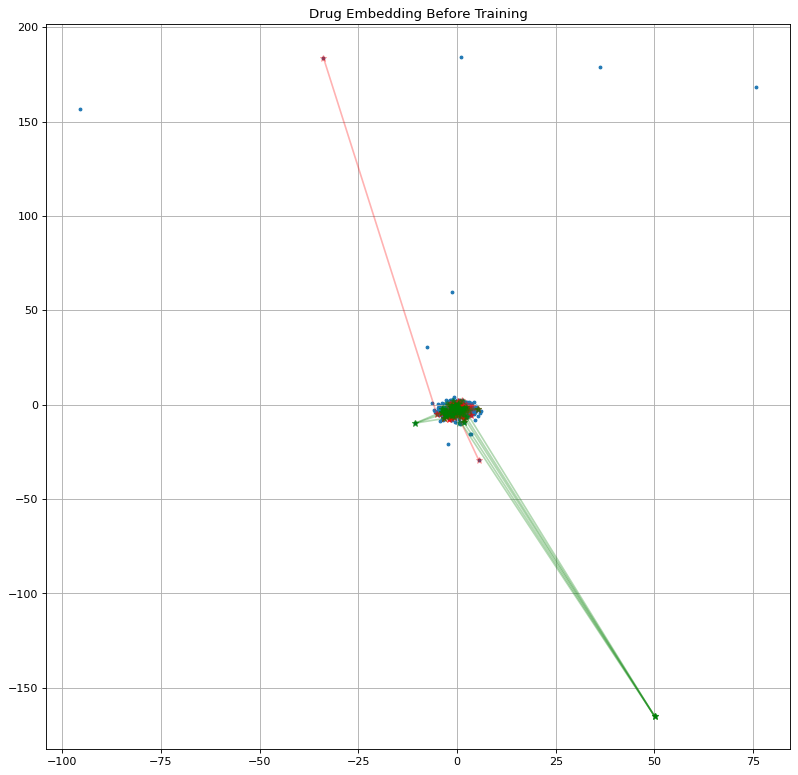

In [ ]:
plt.figure(figsize=(12, 12), dpi= 80, facecolor='w', edgecolor='k')
title = "Drug Embedding Before Training"
col = ['r', 'g', 'b', 'k', 'c', 'm', 'y']

plt.scatter(drug_embedded[:, 0], drug_embedded[:, 1], s=6, label='drug')
for i in range(num_show_edge_index):
    edge = selected_edge_types[i]
    r, c = drug_drug_adj_list[edge].nonzero()
    
    if len(r) > num_show_edge:
        selected_drug_pair_index = np.random.choice(len(r), num_show_edge, replace=False).tolist()
    else:
        selected_drug_pair_index = list(range(len(r)))
        
    for j in selected_drug_pair_index:
        [x1, y1] = drug_embedded[r[j], :]
        [x2, y2] = drug_embedded[c[j], :]
        
        plt.plot([x1, x2], [y1, y2], color=col[i], alpha=0.3, marker='*')
    

# setting
plt.title(title)
plt.grid()
plt.savefig("Drug Embedding before training2.pdf")
plt.show()

## 5. Save to Files

### 5.1 save graph infomation - redundant

In [ ]:
import pickle


In [ ]:
# index saver
with open('./data_decagon/edge_type_to_old.pkl', 'wb') as f:
    pickle.dump(edge_type_to_old, f)
with open('./data_decagon/drug_to_old', 'wb') as f:
    pickle.dump(drug_to_old, f)


In [ ]:
with open('data_decagon/graph_num_info.pkl', 'wb') as f:
    pickle.dump([num_gene, num_drug, num_edge_type, num_drug_additional_feature], f)



### 5.2 save sparse matrix - redundant

In [ ]:
# gene-gene adj
sp.save_npz("data_decagon/gene-sparse-adj.npz", gene_adj)

# gene-drug adj
sp.save_npz("data_decagon/drug-gene-sparse-adj.npz", drug_gene_adj)
sp.save_npz("data_decagon/gene-drug-sparse-adj.npz", gene_drug_adj)

# drug-drug adj
for i in range(num_edge_type):
    sp.save_npz("".join(["data_decagon/drug-sparse-adj/type_", str(i), ".npz"]), drug_drug_adj_list[i])
    

### 5.3 save drug sparse feature vectors - redundant

In [ ]:
# drug feature vector
sp.save_npz("data_decagon/drug-feature-sparse.npz", drug_feat_sparse)


### 6.0 build full drug graph

In [ ]:
import threading

In [ ]:
class AtomicInteger():
    def __init__(self, value=0):
        self._value = int(value)
        self._lock = threading.Lock()
        
    def inc(self, d=1):
        with self._lock:
            self._value += int(d)
            return self._value

    def dec(self, d=1):
        return self.inc(-d)    

    @property
    def value(self):
        with self._lock:
            return self._value

    @value.setter
    def value(self, v):
        with self._lock:
            self._value = int(v)
            return self._value

atomic_int=AtomicInteger()

In [ ]:
import networkx as nx

gene_net = nx.from_numpy_matrix(gene_adj.todense())
# wir muessen hier noch noch den nodes sagen, dass sie gene sind

NameError: ignored

In [ ]:
net_list = []
atomic_int=AtomicInteger()

for i in range(len(drug_drug_adj_list)):
    temp_net = nx.from_numpy_matrix(drug_drug_adj_list[i].todense())
    if temp_net.size()>=500:
        G=nx.MultiGraph()
        G.add_nodes_from(temp_net)
        edge_type_name="test_" + str(i) 
        for edge in list(temp_net.edges):
            G.add_edge(edge[0],edge[1],label=edge_type_name,key=atomic_int.inc())
        if edge_type_name in top50_edge_type_names:
            net_list.append(G)

In [ ]:
#len(top100_edge_types)

In [ ]:
#top100_edge_types

super time costly !!!

In [ ]:
full_drug_graph = nx.compose_all(net_list)
nx.write_gpickle(full_drug_graph,"drive/MyDrive/full_drug_graph_cleaned_50.pkl")

In [ ]:
#ls drive/MyDrive/

better:

In [ ]:
#cd ..

In [ ]:
import networkx as nx
full_drug_graph=nx.read_gpickle("Effectants/GNN/full_drug_graph.pkl")

In [ ]:
#full_drug_graph.nodes[0]

In [ ]:
drug_feat_dense=drug_feat_sparse.todense()
drug_feat_dense[0].shape

NameError: ignored

In [ ]:
list(np.array(drug_feat_dense[0][:])[0])

In [ ]:
np.array(drug_feat_dense[0])[0]

In [ ]:
#add features to nodes
for i in range(len(full_drug_graph.nodes)):
    full_drug_graph.nodes[i]["v"]=list(np.array(drug_feat_dense[i])[0])

In [ ]:
nx.write_gpickle(full_drug_graph,"drive/MyDrive/full_drug_graph_cleaned_with_node_features_top50.pkl")

In [ ]:
full_drug_graph.nodes.data()

NodeDataView({0: {'v': [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [ ]:
#for node in full_drug_graph.nodes.items():
#    print(node)

In [ ]:
np.sum(full_drug_graph.nodes[2]["v"])

160

In [ ]:
full_drug_graph.size()

1631746

In [ ]:
type(full_drug_graph)

networkx.classes.multigraph.MultiGraph

In [ ]:
from stellargraph import StellarGraph

drug_graph = StellarGraph.from_networkx(full_drug_graph,node_features='v')

In [ ]:
print(drug_graph.info())

StellarGraph: Undirected multigraph
 Nodes: 645, Edges: 1631746

 Node types:
  default: [645]
    Features: float32 vector, length 10829
    Edge types: default-test_104->default, default-test_112->default, default-test_120->default, default-test_122->default, default-test_127->default, ... (95 more)

 Edge types:
    default-test_51->default: [28568]
        Weights: all 1 (default)
        Features: none
    default-test_74->default: [27006]
        Weights: all 1 (default)
        Features: none
    default-test_29->default: [26037]
        Weights: all 1 (default)
        Features: none
    default-test_361->default: [25190]
        Weights: all 1 (default)
        Features: none
    default-test_68->default: [24430]
        Weights: all 1 (default)
        Features: none
    default-test_127->default: [24260]
        Weights: all 1 (default)
        Features: none
    default-test_104->default: [23894]
        Weights: all 1 (default)
        Features: none
    default-test_130->

In [ ]:
#drug_graph.node_features()

In [ ]:
drug_graph.nodes()

Int64Index([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,
            ...
            635, 636, 637, 638, 639, 640, 641, 642, 643, 644],
           dtype='int64', length=645)

Remove edges - filter for top 100 edge types

In [ ]:
from collections import Counter

In [ ]:
edge_types=[x[2] for x in drug_graph.edges(include_edge_type=True)]
edge_type_top100=Counter(edge_types).most_common(100)
top100_edge_type_names=[x[0] for x in edge_type_top100]

edge_type_top50=Counter(edge_types).most_common(50)
top50_edge_type_names=[x[0] for x in edge_type_top50]

top50_edge_type_names[:5]

['test_51', 'test_74', 'test_29', 'test_361', 'test_68']

In [ ]:
len(top50_edge_type_names)

50

In [ ]:
#for edge in drug_graph.edges(include_edge_type=True):
#    if edge[2] not in top100_edge_types:
#        drug_graph

#drug_graph.edges(include_edge_type=True)[0][2]

'test_100'

In [ ]:
#if drug_graph.edges(include_edge_type=True)[60000][2] not in top100_edge_types:
#    print(drug_graph.edges(include_edge_type=True)[60000][2])

In [ ]:
drug_graph.edges(include_edge_type=True)[:10]

[(0, 126, 'test_104'),
 (0, 131, 'test_104'),
 (0, 169, 'test_104'),
 (0, 199, 'test_104'),
 (0, 204, 'test_104'),
 (0, 256, 'test_104'),
 (0, 290, 'test_104'),
 (0, 490, 'test_104'),
 (0, 79, 'test_104'),
 (0, 215, 'test_104'),
 (0, 340, 'test_104'),
 (0, 112, 'test_104'),
 (0, 300, 'test_104'),
 (0, 301, 'test_104'),
 (0, 345, 'test_104'),
 (0, 26, 'test_104'),
 (0, 66, 'test_104'),
 (0, 76, 'test_104'),
 (0, 91, 'test_104'),
 (0, 236, 'test_104'),
 (0, 333, 'test_104'),
 (0, 193, 'test_104'),
 (0, 46, 'test_104'),
 (0, 134, 'test_104'),
 (0, 6, 'test_104'),
 (1, 15, 'test_104'),
 (1, 16, 'test_104'),
 (1, 26, 'test_104'),
 (1, 36, 'test_104'),
 (1, 38, 'test_104'),
 (1, 39, 'test_104'),
 (1, 41, 'test_104'),
 (1, 42, 'test_104'),
 (1, 46, 'test_104'),
 (1, 52, 'test_104'),
 (1, 53, 'test_104'),
 (1, 56, 'test_104'),
 (1, 58, 'test_104'),
 (1, 62, 'test_104'),
 (1, 72, 'test_104'),
 (1, 73, 'test_104'),
 (1, 74, 'test_104'),
 (1, 75, 'test_104'),
 (1, 76, 'test_104'),
 (1, 81, 'test_

In [ ]:
df = pd.DataFrame(list(drug_graph.edges(include_edge_type=True)))
df.head()

,0,1,2
0,0,126,test_104
1,0,131,test_104
2,0,169,test_104
3,0,199,test_104
4,0,204,test_104


In [ ]:
import pandas as pd


df = pd.DataFrame(list(drug_graph.edges(include_edge_type=True)))
df.columns = ['source','target', 'label']
df = df[['source', 'label', 'target']]
print(df)

         source     label  target
0             0  test_100     131
1             0  test_100     290
2             1  test_100      26
3             1  test_100      36
4             1  test_100      38
...         ...       ...     ...
4576282     459  test_999     478
4576283     459  test_999     517
4576284     459  test_999     542
4576285     490  test_999     612
4576286     490  test_999     521

[4576287 rows x 3 columns]


In [ ]:
edges_top100=Counter(df.label).most_common(50)
top100_edge_types=[x[0] for x in edge_type_top100]
top100_edge_types[:5]

['test_51', 'test_74', 'test_29', 'test_361', 'test_68']

In [ ]:
#edges_top100

In [ ]:
Counter(df.label).most_common(50)[-1]

('test_175', 15171)

In [ ]:
df_filtered=df.groupby("label").filter(lambda x: len(x) >= 15171)

In [ ]:
df_filtered.to_csv("drive/MyDrive/filtered_dataframe_top50.csv",index=False)

In [ ]:
ls #Effectants/GNN/

drive/  Effectants/  sample_data/


### 7.0 Link prediction

In [ ]:
import pandas as pd
data_full=pd.read_csv("Effectants/GNN/filtered_dataframe_top50.csv")
#data_full

data_part=data_full.loc[data_full["label"]=="test_104"]



,source,label,target
0,0,test_104,126
1,0,test_104,131
2,0,test_104,169
3,0,test_104,199
4,0,test_104,204
...,...,...,...
975512,523,test_83,525
975513,525,test_83,562
975514,534,test_83,560
975515,560,test_83,562


In [ ]:
len(data_t.iloc[:,0].unique())

540

In [ ]:
from collections import Counter
Counter(data_t.iloc[:,1])

Counter({'test_104': 23894,
         'test_122': 20204,
         'test_127': 24260,
         'test_130': 23848,
         'test_134': 15332,
         'test_143': 17639,
         'test_154': 17945,
         'test_16': 17060,
         'test_175': 15171,
         'test_178': 21410,
         'test_179': 21013,
         'test_192': 18785,
         'test_197': 16371,
         'test_205': 15450,
         'test_207': 23515,
         'test_208': 23043,
         'test_212': 17808,
         'test_22': 18779,
         'test_226': 19376,
         'test_234': 21781,
         'test_244': 18061,
         'test_267': 18892,
         'test_272': 17648,
         'test_29': 26037,
         'test_301': 16555,
         'test_307': 21981,
         'test_32': 16575,
         'test_326': 15235,
         'test_330': 21806,
         'test_334': 17658,
         'test_337': 19100,
         'test_343': 17567,
         'test_346': 18980,
         'test_361': 25190,
         'test_364': 16899,
         'test_381': 155

In [ ]:
len(data_t.iloc[:,2].unique())

644

In [ ]:
epochs = 5
embedding_dimension = 100
negative_samples = 2000

In [ ]:
import pandas as pd


df = pd.DataFrame(list(drug_graph.edges(include_edge_type=True)))
df.columns = ['source','target', 'label']
df = df[['source', 'label', 'target']]
print(df)

         source     label  target
0             0  test_100     131
1             0  test_100     290
2             1  test_100      26
3             1  test_100      36
4             1  test_100      38
...         ...       ...     ...
4576282     459  test_999     478
4576283     459  test_999     517
4576284     459  test_999     542
4576285     490  test_999     612
4576286     490  test_999     521

[4576287 rows x 3 columns]


In [ ]:
#Counter(df.label).most_common(100)

In [ ]:
#Counter(df.label)

In [ ]:
from sklearn.model_selection import train_test_split
drug_train, drug_temp = train_test_split(df_filtered, test_size=0.3, random_state=42,stratify=df_filtered.label) #df durch df_filtered ausgetauscht

drug_test, drug_valid = train_test_split(drug_temp, test_size=0.5, random_state=42,stratify=drug_temp.label)

drug_train.reset_index(drop=True, inplace=True)
drug_test.reset_index(drop=True, inplace=True)
drug_valid.reset_index(drop=True, inplace=True)

In [ ]:
from stellargraph import datasets, utils
from tensorflow.keras import callbacks, optimizers, losses, metrics, regularizers, Model
from stellargraph.mapper import KGTripleGenerator
from stellargraph.layer import DistMult


# Train model
drug_gen = KGTripleGenerator(
    drug_graph, batch_size=1024 #len(drug_train) // 10  # ~10 batches per epoch
)

drug_distmult = DistMult(
    drug_gen,
    embedding_dimension=embedding_dimension,
    embeddings_regularizer=regularizers.l2(1e-7),
)

drug_inp, drug_out = drug_distmult.in_out_tensors()

drug_model = Model(inputs=drug_inp, outputs=drug_out)

drug_model.compile(
    optimizer=optimizers.Adam(lr=0.001),
    loss=losses.BinaryCrossentropy(from_logits=True),
    metrics=[metrics.BinaryAccuracy(threshold=0.0)],
)

In [ ]:
drug_train_gen = drug_gen.flow(drug_train, negative_samples=negative_samples, shuffle=True)
drug_valid_gen = drug_gen.flow(drug_valid, negative_samples=negative_samples)

In [ ]:
#computative intensive!!!

drug_es = callbacks.EarlyStopping(monitor="val_loss", patience=50)
drug_history = drug_model.fit(
    drug_train_gen,
    validation_data=drug_valid_gen,
    epochs=epochs,
    callbacks=[drug_es],
    verbose=1,
)

Epoch 1/5
667/667 [==============================] - 432s 643ms/step - loss: 0.4994 - binary_accuracy: 0.7934 - val_loss: 0.0059 - val_binary_accuracy: 0.9995
Epoch 2/5
667/667 [==============================] - 427s 640ms/step - loss: 0.0055 - binary_accuracy: 0.9995 - val_loss: 0.0052 - val_binary_accuracy: 0.9995
Epoch 3/5
667/667 [==============================] - 426s 639ms/step - loss: 0.0052 - binary_accuracy: 0.9995 - val_loss: 0.0051 - val_binary_accuracy: 0.9995
Epoch 4/5
116/667 [====>.........................] - ETA: 4:57 - loss: 0.0051 - binary_accuracy: 0.9995

KeyboardInterrupt: ignored

In [ ]:
utils.plot_history(drug_history)

NameError: ignored

In [ ]:
#evalulate model
drug_smaller_gen = KGTripleGenerator(drug_graph, batch_size=300)

drug_raw_ranks, drug_filtered_ranks = drug_distmult.rank_edges_against_all_nodes(drug_smaller_gen.flow(drug_test), drug_graph)

KeyboardInterrupt: ignored

In [ ]:
# helper function to compute metrics from an array of ranks
def results_as_dataframe(mrr, hits_at_10, hits_at_1):
    return pd.DataFrame(
        [(mrr, hits_at_10, hits_at_1)], columns=["mrr", "hits at 10", "hits at 1"], index=["filtered"],
    )


def summarise(ranks):
    return results_as_dataframe(np.mean(1 / ranks), np.mean(ranks <= 10), np.mean(ranks <= 1))

In [ ]:
import numpy as np

In [ ]:
summarise(drug_filtered_ranks)

,mrr,hits at 10,hits at 1
filtered,0.060297,0.127475,0.017446


In [ ]:
0.034777	0.072666	0.007877

### additional embeddings

In [ ]:
#TODO: https://stellargraph.readthedocs.io/en/stable/api.html#knowledge-graph-models

from stellargraph.layer import ComplEx

# Train model
drug_gen = KGTripleGenerator(
    drug_graph, batch_size=1024#len(drug_train) // 10  # ~10 batches per epoch
)

drug_ComplEx = ComplEx(
    drug_gen,
    embedding_dimension=embedding_dimension,
    embeddings_regularizer=regularizers.l2(1e-7),
)

drug_inp, drug_out = drug_ComplEx.in_out_tensors()

drug_model = Model(inputs=drug_inp, outputs=drug_out)

drug_model.compile(
    optimizer=optimizers.Adam(lr=0.0001),
    loss=losses.BinaryCrossentropy(from_logits=True),
    metrics=[metrics.BinaryAccuracy(threshold=0.0)],
)

In [ ]:
drug_train_gen = drug_gen.flow(drug_train, negative_samples=negative_samples, shuffle=True)
drug_valid_gen = drug_gen.flow(drug_valid, negative_samples=negative_samples)

drug_es = callbacks.EarlyStopping(monitor="val_loss", patience=50)
drug_history2 = drug_model.fit(
    drug_train_gen,
    validation_data=drug_valid_gen,
    epochs=epochs,
    callbacks=[drug_es],
    verbose=1,
)

In [ ]:
utils.plot_history(drug_history2)

In [ ]:
from stellargraph.layer import RotatE

# Train model
drug_gen = KGTripleGenerator(
    drug_graph, batch_size=len(drug_train) // 10  # ~10 batches per epoch
)

drug_RotatE = RotatE(
    drug_gen,
    embedding_dimension=embedding_dimension,
    embeddings_regularizer=regularizers.l2(1e-7),
)

drug_inp, drug_out = drug_RotatE.in_out_tensors()

drug_model = Model(inputs=drug_inp, outputs=drug_out)

drug_model.compile(
    optimizer=optimizers.Adam(lr=0.001),
    loss=losses.BinaryCrossentropy(from_logits=True),
    metrics=[metrics.BinaryAccuracy(threshold=0.0)],
)

In [ ]:
drug_train_gen = drug_gen.flow(drug_train, negative_samples=negative_samples, shuffle=True)
drug_valid_gen = drug_gen.flow(drug_valid, negative_samples=negative_samples)

drug_es = callbacks.EarlyStopping(monitor="val_loss", patience=50)
drug_history = drug_model.fit(
    drug_train_gen,
    validation_data=drug_valid_gen,
    epochs=epochs,
    callbacks=[drug_es],
    verbose=1,
)

In [ ]:
utils.plot_history(drug_history)

In [ ]:
#evalulate model
drug_smaller_gen = KGTripleGenerator(drug_graph, batch_size=5000)

drug_raw_ranks, drug_filtered_ranks = drug_RotatE.rank_edges_against_all_nodes(drug_smaller_gen.flow(drug_test), drug_graph)

summarise(drug_filtered_ranks)

In [ ]:
from stellargraph.layer import Node2Vec

In [ ]:
from stellargraph.layer import Node2Vec
from stellargraph.mapper import Node2VecLinkGenerator, Node2VecNodeGenerator

batch_size=8

# Train model
drug_gen = KGTripleGenerator(
    drug_graph, batch_size=len(drug_train) // 10  # ~10 batches per epoch
)

# Define a Node2Vec training generator, which generates batches of training pairs
generator = Node2VecLinkGenerator(drug_graph, batch_size)

# Create the Node2Vec model
node2vec = Node2Vec(embedding_dimension, generator=generator)

drug_inp, drug_out = node2vec.in_out_tensors()

drug_model = Model(inputs=drug_inp, outputs=drug_out)

drug_model.compile(
    optimizer=optimizers.Adam(lr=0.001),
    loss=losses.BinaryCrossentropy(from_logits=True),
    metrics=[metrics.BinaryAccuracy(threshold=0.0)],
)

In [ ]:
drug_train_gen = drug_gen.flow(drug_train, negative_samples=negative_samples, shuffle=True)
drug_valid_gen = drug_gen.flow(drug_valid, negative_samples=negative_samples)

#drug_es = callbacks.EarlyStopping(monitor="val_loss", patience=50)
#drug_history = drug_model.fit(
#    drug_train_gen,
#    validation_data=drug_valid_gen,
#    epochs=epochs,
#    callbacks=[drug_es],
#    verbose=1,
#)

In [ ]:
utils.plot_history(drug_history)

# Normal ML Approach

- TODO: 
- noch DistMult, Node2Vec mitreinbringen
- p-GNN
- Local  und global (bspw. PageRange)


In [ ]:
import matplotlib.pyplot as plt
from tqdm import tqdm
import networkx as nx
import numpy as np
import pandas as pd

!pip install node2vec

In [ ]:
!pip freeze

absl-py==0.10.0
alabaster==0.7.12
albumentations==0.1.12
altair==4.1.0
appdirs==1.4.4
argon2-cffi==20.1.0
asgiref==3.3.1
astor==0.8.1
astropy==4.2
astunparse==1.6.3
async-generator==1.10
atari-py==0.2.6
atomicwrites==1.4.0
attrs==20.3.0
audioread==2.1.9
autograd==1.3
Babel==2.9.0
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==3.3.0
blis==0.4.1
bokeh==2.1.1
Bottleneck==1.3.2
branca==0.4.2
bs4==0.0.1
CacheControl==0.12.6
cachetools==4.2.1
catalogue==1.0.0
certifi==2020.12.5
cffi==1.14.5
chainer==7.4.0
chardet==3.0.4
click==7.1.2
cloudpickle==1.3.0
cmake==3.12.0
cmdstanpy==0.9.5
colorlover==0.3.0
community==1.0.0b1
contextlib2==0.5.5
convertdate==2.3.1
coverage==3.7.1
coveralls==0.5
crcmod==1.7
cufflinks==0.17.3
cupy-cuda101==7.4.0
cvxopt==1.2.6
cvxpy==1.0.31
cycler==0.10.0
cymem==2.0.5
Cython==0.29.22
daft==0.0.4
dask==2.12.0
datascience==0.10.6
debugpy==1.0.0
decorator==4.4.2
defusedxml==0.7.1
descartes==1.1.0
dill==0.3.3
distributed==1.25.3
Django==3.1.7
dlib==19.18.0
dm-tree==0.1.5
doc

In [ ]:
data_full=pd.read_csv("Effectants/GNN/filtered_dataframe_top50.csv")

data_part=data_full.loc[data_full["label"]=="test_104"]

In [ ]:
data_part=data_part[["source","target"]]
fb_df=data_part.rename(columns={"source":"node_1","target":"node_2"})
fb_df

,node_1,node_2
0,0,126
1,0,131
2,0,169
3,0,199
4,0,204
...,...,...
23889,559,599
23890,561,568
23891,562,575
23892,562,578


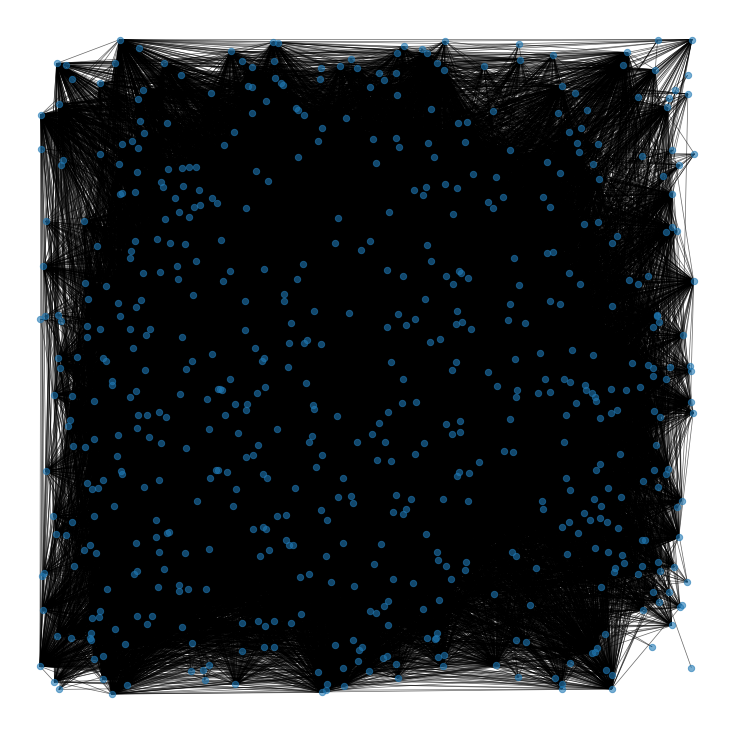

In [ ]:
# create graph
G = nx.from_pandas_edgelist(fb_df, "node_1", "node_2", create_using=nx.Graph())

# plot graph
plt.figure(figsize=(10,10))

pos = nx.random_layout(G, seed=23)
nx.draw(G, with_labels=False,  pos = pos, node_size = 40, alpha = 0.6, width = 0.7)

plt.show()

In [ ]:
node_list_1=fb_df.iloc[:,0]
node_list_2=fb_df.iloc[:,1]

In [ ]:
# combine all nodes in a list
node_list = node_list_1 + node_list_2

# remove duplicate items from the list
#node_list = list(set(node_list))

node_list = [*node_list_1, *node_list_2]
node_list=list(set(node_list))

# build adjacency matrix
adj_G = nx.to_numpy_matrix(G, nodelist = node_list)

In [ ]:
# get unconnected node-pairs
all_unconnected_pairs = []

# traverse adjacency matrix
offset = 0
for i in tqdm(range(adj_G.shape[0])):
  for j in range(offset,adj_G.shape[1]):
    if i != j:
      if adj_G[i,j] == 0:
        if nx.shortest_path_length(G, node_list[i], node_list[j]) <=2:
          all_unconnected_pairs.append([node_list[i],node_list[j]])

  offset = offset + 1

100%|██████████| 606/606 [00:03<00:00, 165.98it/s]


In [ ]:
len(all_unconnected_pairs)

133778

In [ ]:
node_1_unlinked = [i[0] for i in all_unconnected_pairs]
node_2_unlinked = [i[1] for i in all_unconnected_pairs]

data = pd.DataFrame({'node_1':node_1_unlinked, 
                     'node_2':node_2_unlinked})

# add target variable 'link'
data['link'] = 0

In [ ]:
initial_node_count = len(G.nodes)

fb_df_temp = fb_df.copy()

# empty list to store removable links
omissible_links_index = []

for i in tqdm(fb_df.index.values):
  
  # remove a node pair and build a new graph
  G_temp = nx.from_pandas_edgelist(fb_df_temp.drop(index = i), "node_1", "node_2", create_using=nx.Graph())
  
  # check there is no spliting of graph and number of nodes is same
  if (len(G_temp.nodes) == initial_node_count) and (nx.number_connected_components(G_temp) == 1):
    omissible_links_index.append(i)
    fb_df_temp = fb_df_temp.drop(index = i)


 36%|███▌      | 8555/23894 [04:49<07:29, 34.10it/s]

In [ ]:
len(omissible_links_index)

23289

In [ ]:
# create dataframe of removable edges
fb_df_ghost = fb_df.loc[omissible_links_index]

# add the target variable 'link'
fb_df_ghost['link'] = 1

data = data.append(fb_df_ghost[['node_1', 'node_2', 'link']], ignore_index=True)

In [ ]:
data['link'].value_counts()

0    133778
1     23289
Name: link, dtype: int64

In [ ]:
# drop removable edges
fb_df_partial = fb_df.drop(index=fb_df_ghost.index.values)

# build graph
G_data = nx.from_pandas_edgelist(fb_df_partial, "node_1", "node_2", create_using=nx.Graph())

In [ ]:
from node2vec import Node2Vec

# Generate walks
node2vec = Node2Vec(G_data, dimensions=100, walk_length=16, num_walks=50)

# train node2vec model
n2w_model = node2vec.fit(window=7, min_count=1)


Generating walks (CPU: 1):   0%|          | 0/50 [00:00<?, ?it/s]


Generating walks (CPU: 1): 100%|██████████| 50/50 [00:16<00:00,  3.01it/s]


In [ ]:
x = [(n2w_model[str(i)]+n2w_model[str(j)]) for i,j in zip(data['node_1'], data['node_2'])]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

In [ ]:
xtrain, xtest, ytrain, ytest = train_test_split(np.array(x), data['link'], 
                                                test_size = 0.3, 
                                                random_state = 35)

In [ ]:
lr = LogisticRegression(class_weight="balanced")

lr.fit(xtrain, ytrain)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


LogisticRegression(C=1.0, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=100, multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [ ]:
predictions = lr.predict_proba(xtest)

In [ ]:
roc_auc_score(ytest, predictions[:,1])

0.6485235353846113

In [ ]:
import lightgbm as lgbm

train_data = lgbm.Dataset(xtrain, ytrain)
test_data = lgbm.Dataset(xtest, ytest)

# define parameters
parameters = {
    'objective': 'binary',
    'metric': 'auc',
    'is_unbalance': 'true',
    'feature_fraction': 0.5,
    'bagging_fraction': 0.5,
    'bagging_freq': 20,
    'num_threads' : 2,
    'seed' : 76
}

# train lightGBM model
model = lgbm.train(parameters,
                   train_data,
                   valid_sets=test_data,
                   num_boost_round=1000,
                   early_stopping_rounds=20)

[1]	valid_0's auc: 0.577714
Training until validation scores don't improve for 20 rounds.
[2]	valid_0's auc: 0.591615
[3]	valid_0's auc: 0.600867
[4]	valid_0's auc: 0.605772
[5]	valid_0's auc: 0.610339
[6]	valid_0's auc: 0.612114
[7]	valid_0's auc: 0.613669
[8]	valid_0's auc: 0.615161
[9]	valid_0's auc: 0.617753
[10]	valid_0's auc: 0.62075
[11]	valid_0's auc: 0.622381
[12]	valid_0's auc: 0.623833
[13]	valid_0's auc: 0.624596
[14]	valid_0's auc: 0.625587
[15]	valid_0's auc: 0.628379
[16]	valid_0's auc: 0.62934
[17]	valid_0's auc: 0.630463
[18]	valid_0's auc: 0.632473
[19]	valid_0's auc: 0.633045
[20]	valid_0's auc: 0.63448
[21]	valid_0's auc: 0.635758
[22]	valid_0's auc: 0.637406
[23]	valid_0's auc: 0.638808
[24]	valid_0's auc: 0.640414
[25]	valid_0's auc: 0.641529
[26]	valid_0's auc: 0.642358
[27]	valid_0's auc: 0.642894
[28]	valid_0's auc: 0.644138
[29]	valid_0's auc: 0.644717
[30]	valid_0's auc: 0.646107
[31]	valid_0's auc: 0.64635
[32]	valid_0's auc: 0.647184
[33]	valid_0's auc: 0.6

# DistMult

In [ ]:
!pip uninstall tensorflow
!pip install tensorflow==1.14

Uninstalling tensorflow-1.15.0:
  Would remove:
    /usr/local/bin/estimator_ckpt_converter
    /usr/local/bin/freeze_graph
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.7/dist-packages/tensorflow-1.15.0.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorflow/*
    /usr/local/lib/python3.7/dist-packages/tensorflow_core/*
Proceed (y/n)? y
  Successfully uninstalled tensorflow-1.15.0
     |████████████████████████████████| 109.3MB 98kB/s 
     |████████████████████████████████| 3.2MB 42.9MB/s 
     |████████████████████████████████| 491kB 49.8MB/s 
  Found existing installation: tensorboard 1.15.0
    Uninstalling tensorboard-1.15.0:
      Successfully uninstalled tensorboard-1.15.0
  Found existing installation: tensorflow-estimator 1.15.1
    Uninstalling tensorflow-estimator-1.15.1:
      Successfully un

In [ ]:
!pip install tensorflow-hub==0.10.0

     |████████████████████████████████| 112kB 15.1MB/s 
  Found existing installation: tensorflow-hub 0.11.0
    Uninstalling tensorflow-hub-0.11.0:
      Successfully uninstalled tensorflow-hub-0.11.0


In [ ]:
!pip install ampligraph

     |████████████████████████████████| 153kB 18.0MB/s 
     |████████████████████████████████| 81kB 11.8MB/s 
     |████████████████████████████████| 2.8MB 35.3MB/s 
     |████████████████████████████████| 2.7MB 45.7MB/s 
     |████████████████████████████████| 235kB 52.2MB/s 
     |████████████████████████████████| 51kB 8.3MB/s 
     |████████████████████████████████| 71kB 10.1MB/s 
     |████████████████████████████████| 51kB 8.8MB/s 
     |████████████████████████████████| 563kB 48.8MB/s 
     |████████████████████████████████| 102kB 15.5MB/s 
     |████████████████████████████████| 92kB 13.3MB/s 
     |████████████████████████████████| 122kB 54.6MB/s 
     |████████████████████████████████| 92kB 12.8MB/s 
     |████████████████████████████████| 51kB 8.0MB/s 
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
  Found existing installation: Sphinx 1.8.5
    Uninstalling Sphinx-1.8.5:
      Successfully uninstalled Sphinx-1.8.

In [ ]:
from ampligraph.latent_features import DistMult
model = DistMult(batches_count=1, seed=555, epochs=20, k=10, loss='pairwise', loss_params={'margin':5})

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

WARNING - All triples will be processed in the same batch (batches_count=1). When processing large graphs it is recommended to batch the input knowledge graph instead.


In [ ]:
import pandas as pd
import numpy as np
data_full=pd.read_csv("Effectants/GNN/filtered_dataframe_top50.csv")

data_part=data_full.loc[data_full["label"]=="test_104"]

In [ ]:
data_part['source'] = data_part['source'].astype(str)
data_part['target'] = data_part['target'].astype(str)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
data_part

,source,label,target
0,0,test_104,126
1,0,test_104,131
2,0,test_104,169
3,0,test_104,199
4,0,test_104,204
...,...,...,...
23889,559,test_104,599
23890,561,test_104,568
23891,562,test_104,575
23892,562,test_104,578


In [ ]:
triplets=np.array(data_part.values.tolist())

In [ ]:
X=triplets[:]

In [ ]:
model.fit(X)


In [ ]:
model.predict(np.array([['0', 'test_104', '127']]))

array([-0.00385766], dtype=float32)

In [ ]:
X[0]

'0'

In [ ]:
model.get_embeddings(["0","125"], embedding_type="entity")

array([[-0.01458519, -0.028171  ,  0.04291622, -0.13476104,  0.00128788,
        -0.00917175,  0.05261168,  0.0489809 , -0.00499429,  0.05209191],
       [ 0.03540649,  0.07896394,  0.02209407,  0.05736703,  0.05215995,
         0.04913694,  0.03613449, -0.1228672 , -0.03347039,  0.02987737]],
      dtype=float32)